# Imports

In [1]:
!pip install altair


In [2]:
pip install matplotlib

Note: you may need to restart the kernel to use updated packages.


In [11]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler, OneHotEncoder
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import altair as alt

import os

file_path = r"D:\MP\B82-Clustering Social Media Users Based on Behavior\modified_dataset.csv"

if os.path.exists(file_path):
    print("File found!")
    df = pd.read_csv(file_path)  # Load the dataset
    print(df.head())  # Display first few rows
else:
    print("File not found. Check the path.")


File found!
   gradyear gender     age  NumberOffriends  basketball  football  soccer  \
0      2007    NaN     NaN                0           0         0       0   
1      2007      F   17.41               49           0         0       1   
2      2007      F  17.511               41           0         0       0   
3      2006      F     NaN               36           0         0       0   
4      2008      F  16.657                1           0         0       0   

   softball  volleyball  swimming  ...  blonde  mall  shopping  clothes  \
0         0           0         0  ...       0     0         0        0   
1         0           0         1  ...       0     0         0        0   
2         0           0         0  ...       0     1         0        0   
3         0           0         0  ...       0     0         0        0   
4         0           0         1  ...       0     0         0        3   

   hollister  abercrombie  die  death  drunk  drugs  
0          0        

# EDA

In [12]:
df = pd.read_csv('modified_dataset.csv')
df.head()

,gradyear,gender,age,NumberOffriends,basketball,football,soccer,softball,volleyball,swimming,...,blonde,mall,shopping,clothes,hollister,abercrombie,die,death,drunk,drugs
0,2007,NaN,NaN,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,2007,F,17.41,49,0,0,1,0,0,1,...,0,0,0,0,0,0,0,0,1,0
2,2007,F,17.511,41,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,1,1
3,2006,F,NaN,36,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,2008,F,16.657,1,0,0,0,0,0,1,...,0,0,0,3,0,0,0,0,0,0


- We can see from the data that we'll need to scale most of the numerical columns.
- Age is not included in the describe() function below, indicating we need to change the datatype.

In [14]:
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15000 entries, 0 to 14999
Data columns (total 36 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   gradyear         15000 non-null  int64 
 1   gender           13663 non-null  object
 2   age              12504 non-null  object
 3   NumberOffriends  15000 non-null  int64 
 4   basketball       15000 non-null  int64 
 5   football         15000 non-null  int64 
 6   soccer           15000 non-null  int64 
 7   softball         15000 non-null  int64 
 8   volleyball       15000 non-null  int64 
 9   swimming         15000 non-null  int64 
 10  cheerleading     15000 non-null  int64 
 11  baseball         15000 non-null  int64 
 12  tennis           15000 non-null  int64 
 13  sports           15000 non-null  int64 
 14  cute             15000 non-null  int64 
 15  dance            15000 non-null  int64 
 16  band             15000 non-null  int64 
 17  marching         15000 non-null

In [13]:
df.describe()

,gradyear,NumberOffriends,basketball,football,soccer,softball,volleyball,swimming,cheerleading,baseball,...,blonde,mall,shopping,clothes,hollister,abercrombie,die,death,drunk,drugs
count,15000.000000,15000.000000,15000.000000,15000.000000,15000.00000,15000.000000,15000.000000,15000.000000,15000.000000,15000.000000,...,15000.000000,15000.000000,15000.000000,15000.000000,15000.000000,15000.000000,15000.000000,15000.000000,15000.000000,15000.000000
mean,2007.496933,29.834533,0.267000,0.255467,0.22200,0.159667,0.142933,0.135000,0.105133,0.104133,...,0.112867,0.259467,0.357267,0.150267,0.071800,0.051467,0.185867,0.118067,0.091733,0.061067
std,1.116516,35.386649,0.788851,0.702260,0.92042,0.737344,0.638747,0.548691,0.502491,0.519205,...,2.708619,0.704398,0.728512,0.478716,0.356258,0.280755,0.609928,0.455200,0.420631,0.349112
min,2006.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2006.000000,3.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,2008.000000,20.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,2008.000000,44.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,2009.000000,605.000000,22.000000,9.000000,22.00000,17.000000,14.000000,31.000000,8.000000,14.000000,...,327.000000,12.000000,11.000000,8.000000,8.000000,8.000000,16.000000,14.000000,8.000000,16.000000


In [15]:
df.dtypes

gradyear            int64
gender             object
age                object
NumberOffriends     int64
basketball          int64
football            int64
soccer              int64
softball            int64
volleyball          int64
swimming            int64
cheerleading        int64
baseball            int64
tennis              int64
sports              int64
cute                int64
dance               int64
band                int64
marching            int64
music               int64
rock                int64
god                 int64
church              int64
jesus               int64
bible               int64
hair                int64
dress               int64
blonde              int64
mall                int64
shopping            int64
clothes             int64
hollister           int64
abercrombie         int64
die                 int64
death               int64
drunk               int64
drugs               int64
dtype: object

We'll need to address the nulls in gender and age in our data processing/

In [16]:
df.isnull().sum()

gradyear              0
gender             1337
age                2496
NumberOffriends       0
basketball            0
football              0
soccer                0
softball              0
volleyball            0
swimming              0
cheerleading          0
baseball              0
tennis                0
sports                0
cute                  0
dance                 0
band                  0
marching              0
music                 0
rock                  0
god                   0
church                0
jesus                 0
bible                 0
hair                  0
dress                 0
blonde                0
mall                  0
shopping              0
clothes               0
hollister             0
abercrombie           0
die                   0
death                 0
drunk                 0
drugs                 0
dtype: int64

# Addressing Nulls

I'll create a new U = unknown category which we can convert into a categorical variable.

In [26]:
df['gender'] = df['gender'].fillna('U')
df['gender'].value_counts(dropna=False).reset_index(name="Count")


,gender,Count
0,F,11057
1,M,2606
2,U,1337


I will fill in the age by using the mean across the entire dataset. Since the gradyear fully populated, I can do better by using the average age per grad year instead.

In [24]:
df['age'] = pd.to_numeric(df['age'], errors='coerce')
df['age'].value_counts(dropna=False)
df.groupby('gradyear')['age'].mean()

gradyear
2006    18.601170
2007    17.916778
2008    17.067564
2009    16.304875
Name: age, dtype: float64

C:\Users\aruny\AppData\Local\Temp\ipykernel_35108\4015110286.py:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x="gradyear", y="age", data=gradyear_avg_age, palette="coolwarm")


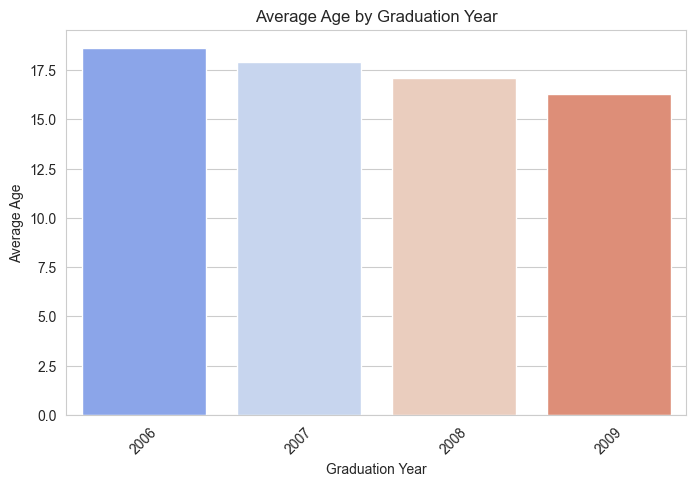

In [35]:
# %pip install seaborn

import matplotlib.pyplot as plt
import seaborn as sns

# Set plot style
sns.set_style("whitegrid")

# 1. Histogram: Distribution of Ages
# plt.figure(figsize=(8, 5))
# sns.histplot(df['age'], bins=20, kde=True, color="skyblue")
# plt.xlabel("Age")
# plt.ylabel("Count")
# plt.title("Distribution of Ages")
# plt.show()

# 2. Bar Chart: Average Age per Gradyear
plt.figure(figsize=(8, 5))
gradyear_avg_age = df.groupby('gradyear')['age'].mean().reset_index()

sns.barplot(x="gradyear", y="age", data=gradyear_avg_age, palette="coolwarm")
plt.xlabel("Graduation Year")
plt.ylabel("Average Age")
plt.title("Average Age by Graduation Year")
plt.xticks(rotation=45)
plt.show()


In [37]:
df['age'] = df.groupby('gradyear')['age'].transform(lambda x: x.fillna(x.mean()))
df['age'].value_counts(dropna=False)

age
16    3867
17    3847
18    3652
15    2009
19    1355
      ... 
88       1
11       1
51       1
84       1
12       1
Name: count, Length: 64, dtype: int64

There are outlier ages >100 and <16. For now, I'll keep them in there but we could replace these outliers with the average at a later step.

In [21]:
df.age = df.age.astype(int)
df.age.describe()

count    15000.000000
mean        17.474867
std          6.979156
min          4.000000
25%         16.000000
50%         17.000000
75%         18.000000
max        106.000000
Name: age, dtype: float64

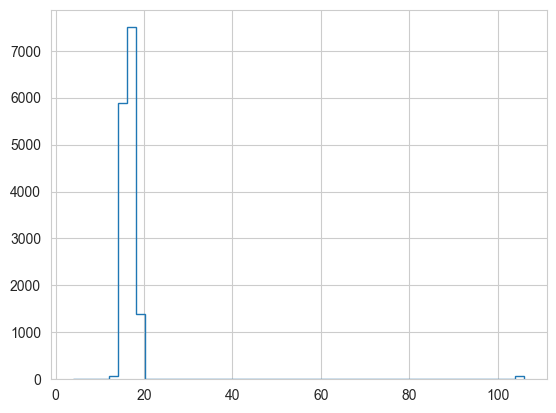

In [44]:
counts, bins = np.histogram(df.age, bins=50)
plt.stairs(counts, bins)

# Pre-Processing

K-means clustering uses Euclidean distance so scaling is critical. From our quick EDA above, we need to do two things:
  1. Scale numerical features (either Standard, Normal, MinMax)
  2. Encode categorical features. Since gender is nominal and has few categories, we'll use one-hot encoding.

In [45]:
# for this, I'm choosing MinMax because standard scaler is sensitive to outliers.
int_columns = df.select_dtypes(include='int')
print(int_columns.columns)

scaler = MinMaxScaler().fit(int_columns)
features = scaler.transform(int_columns)
pd.DataFrame(features, columns=int_columns.columns).head()

Index(['gradyear', 'age', 'NumberOffriends', 'basketball', 'football',
       'soccer', 'softball', 'volleyball', 'swimming', 'cheerleading',
       'baseball', 'tennis', 'sports', 'cute', 'dance', 'band', 'marching',
       'music', 'rock', 'god', 'church', 'jesus', 'bible', 'hair', 'dress',
       'blonde', 'mall', 'shopping', 'clothes', 'hollister', 'abercrombie',
       'die', 'death', 'drunk', 'drugs'],
      dtype='object')


,gradyear,age,NumberOffriends,basketball,football,soccer,softball,volleyball,swimming,cheerleading,...,blonde,mall,shopping,clothes,hollister,abercrombie,die,death,drunk,drugs
0,0.333333,0.137255,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,...,0.0,0.000000,0.0,0.000,0.0,0.0,0.0,0.0,0.000,0.0000
1,0.333333,0.127451,0.080992,0.0,0.0,0.045455,0.0,0.0,0.032258,0.0,...,0.0,0.000000,0.0,0.000,0.0,0.0,0.0,0.0,0.125,0.0000
2,0.333333,0.127451,0.067769,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,...,0.0,0.083333,0.0,0.000,0.0,0.0,0.0,0.0,0.125,0.0625
3,0.000000,0.147059,0.059504,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,...,0.0,0.000000,0.0,0.000,0.0,0.0,0.0,0.0,0.000,0.0000
4,0.666667,0.117647,0.001653,0.0,0.0,0.000000,0.0,0.0,0.032258,0.0,...,0.0,0.000000,0.0,0.375,0.0,0.0,0.0,0.0,0.000,0.0000


In [46]:
encoder = OneHotEncoder(drop='first', sparse_output=False)
encoded_data = encoder.fit_transform(df[['gender']])
pd.DataFrame(encoded_data, columns=encoder.get_feature_names_out(['gender']))

,gender_M,gender_U
0,0.0,1.0
1,0.0,0.0
2,0.0,0.0
3,0.0,0.0
4,0.0,0.0
...,...,...
14995,0.0,0.0
14996,0.0,0.0
14997,0.0,0.0
14998,0.0,0.0


In [47]:
df_scaled = pd.DataFrame(features, columns=int_columns.columns)
df_encoded = pd.DataFrame(encoded_data, columns=encoder.get_feature_names_out(['gender']))
df_merged = df_encoded.merge(df_scaled, left_index=True, right_index=True, how='inner')
print(df_merged.shape)
df_merged.head()

(15000, 37)


,gender_M,gender_U,gradyear,age,NumberOffriends,basketball,football,soccer,softball,volleyball,...,blonde,mall,shopping,clothes,hollister,abercrombie,die,death,drunk,drugs
0,0.0,1.0,0.333333,0.137255,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.000000,0.0,0.000,0.0,0.0,0.0,0.0,0.000,0.0000
1,0.0,0.0,0.333333,0.127451,0.080992,0.0,0.0,0.045455,0.0,0.0,...,0.0,0.000000,0.0,0.000,0.0,0.0,0.0,0.0,0.125,0.0000
2,0.0,0.0,0.333333,0.127451,0.067769,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.083333,0.0,0.000,0.0,0.0,0.0,0.0,0.125,0.0625
3,0.0,0.0,0.000000,0.147059,0.059504,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.000000,0.0,0.000,0.0,0.0,0.0,0.0,0.000,0.0000
4,0.0,0.0,0.666667,0.117647,0.001653,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.000000,0.0,0.375,0.0,0.0,0.0,0.0,0.000,0.0000


# Pipeline and Modeling

In [48]:
def pre_processing(df):
    # null processing
    df['gender'] = df['gender'].fillna('U')
    df['age'] = pd.to_numeric(df['age'], errors='coerce')
    df['age'] = df.groupby('gradyear')['age'].transform(lambda x: x.fillna(x.mean()))
    df.age = df.age.astype(int)

    # scaling and encoding
    int_columns = df.select_dtypes(include='int')
    scaler = MinMaxScaler().fit(int_columns)
    features = scaler.transform(int_columns)
    df_scaled = pd.DataFrame(features, columns=int_columns.columns)

    encoder = OneHotEncoder(drop='first', sparse_output=False)
    encoded_data = encoder.fit_transform(df[['gender']])
    df_encoded = pd.DataFrame(encoded_data, columns=encoder.get_feature_names_out(['gender']))

    df_merged = df_encoded.merge(df_scaled, left_index=True, right_index=True, how='inner')

    return df_merged

In [49]:
df = pd.read_csv('modified_dataset.csv')
print('Before:', df.shape)
df = pre_processing(df)
print('After:', df.shape)
df.head()

Before: (15000, 36)
After: (15000, 37)


,gender_M,gender_U,gradyear,age,NumberOffriends,basketball,football,soccer,softball,volleyball,...,blonde,mall,shopping,clothes,hollister,abercrombie,die,death,drunk,drugs
0,0.0,1.0,0.333333,0.137255,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.000000,0.0,0.000,0.0,0.0,0.0,0.0,0.000,0.0000
1,0.0,0.0,0.333333,0.127451,0.080992,0.0,0.0,0.045455,0.0,0.0,...,0.0,0.000000,0.0,0.000,0.0,0.0,0.0,0.0,0.125,0.0000
2,0.0,0.0,0.333333,0.127451,0.067769,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.083333,0.0,0.000,0.0,0.0,0.0,0.0,0.125,0.0625
3,0.0,0.0,0.000000,0.147059,0.059504,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.000000,0.0,0.000,0.0,0.0,0.0,0.0,0.000,0.0000
4,0.0,0.0,0.666667,0.117647,0.001653,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.000000,0.0,0.375,0.0,0.0,0.0,0.0,0.000,0.0000


In [50]:
kmeans = KMeans(n_clusters=10, random_state=0, n_init='auto').fit(df)
kmeans.labels_

array([3, 8, 8, ..., 8, 8, 5], dtype=int32)

In [ ]:
# Check the cluster distribution
np.unique(kmeans.labels_, return_counts=True)

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype=int32),
 array([2611, 1450, 2682, 1015, 1156,  615,  322,  303, 2611, 2235]))

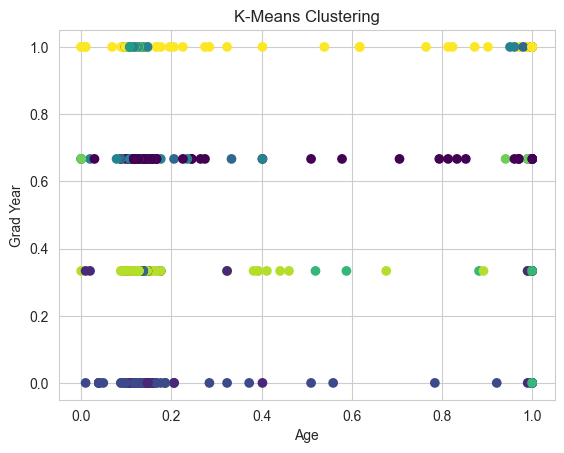

In [ ]:
# Visualize the clusters
plt.scatter(df['age'], df['gradyear'], c=kmeans.labels_, cmap='viridis')
plt.xlabel('Age')
plt.ylabel('Grad Year')
plt.title('K-Means Clustering')
plt.show()


Finds the number of users in each cluster.
Helps us understand which clusters are large or small.

In [54]:
import numpy as np

unique_labels, counts = np.unique(kmeans.labels_, return_counts=True)
for label, count in zip(unique_labels, counts):
    print(f"Cluster {label}: {count} users")

Cluster 0: 2611 users
Cluster 1: 1450 users
Cluster 2: 2682 users
Cluster 3: 1015 users
Cluster 4: 1156 users
Cluster 5: 615 users
Cluster 6: 322 users
Cluster 7: 303 users
Cluster 8: 2611 users
Cluster 9: 2235 users


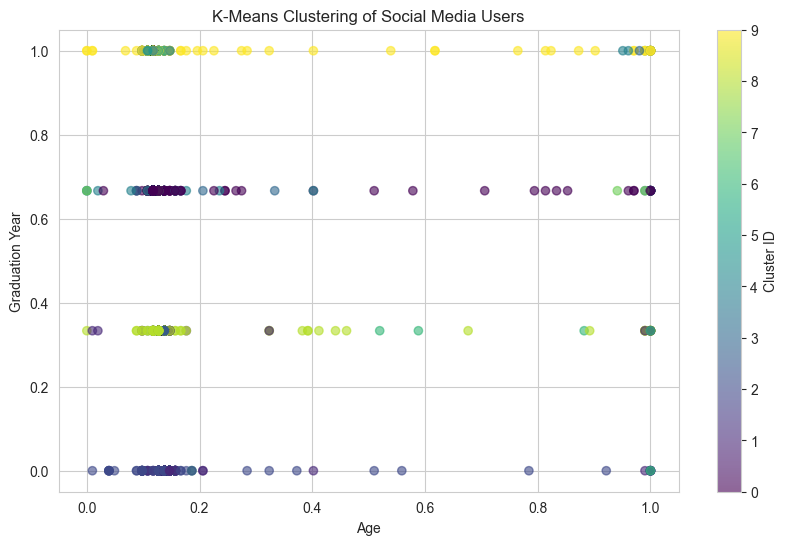

In [55]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.scatter(df['age'], df['gradyear'], c=kmeans.labels_, cmap='viridis', alpha=0.6)
plt.colorbar(label="Cluster ID")
plt.xlabel("Age")
plt.ylabel("Graduation Year")
plt.title("K-Means Clustering of Social Media Users")
plt.show()

Time to find the optimal number of clusters for our model. According to the web, the Elbow Method and Silhouette Scores can both be used to determine the optimal k.
- **Elbow Method:** calculates Within-Cluster Sum of Squared Errors (WCSS) for different k values. Plot WCSS vs. k and find the "elbow" point.
- **Silhouette Score:** calculate Silhouette Score for different k values. Choose k with the highest average Silhouette Score which ranges from [-1, 1].

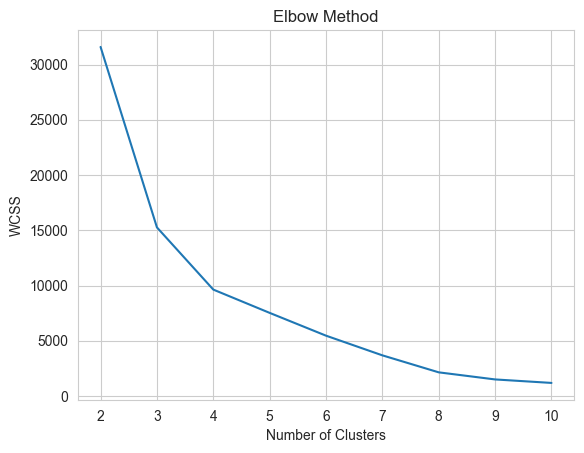

In [59]:
# Elbow Method
wcss = []
for i in range(2, 11):
    kmeans = KMeans(n_clusters=i, n_init=10, random_state=42)
    kmeans.fit(df)
    wcss.append(kmeans.inertia_)

plt.plot(range(2,11), wcss)
plt.title('Elbow Method')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.show()

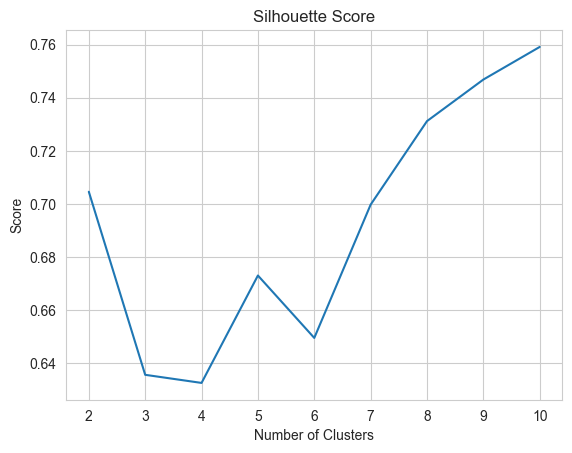

In [60]:
# Silhouette score - can't be calculate when k=1
sil_score = []
for i in range(2,11):
    kmeans = KMeans(n_clusters=i, n_init=10, random_state=42)
    kmeans.fit(df)
    score = silhouette_score(df, kmeans.labels_)
    sil_score.append(score)

plt.plot(range(2,11), sil_score)
plt.title('Silhouette Score')
plt.xlabel('Number of Clusters')
plt.ylabel('Score')
plt.show()

The Elbow Method recommends k=4 clusters while the Silhouette Score recommends k=4 or 5. When comparing the techniques, the Elbow Method only uses the euclidean distance between centroids while the Silhouette Score factors in the intra-cluster and nearest-cluster distance.

I'll do some basic analysis on k=4. k=4 makes intuitive sense due to the nature of the dataset containing four gradyears of students so I want to check that the clustering algorithm didn't just cluster on this feature.

In [61]:
# final model
kmeans = KMeans(n_clusters=4, n_init=10).fit(df)
kmeans.labels_

array([2, 1, 1, ..., 1, 1, 3], dtype=int32)

# Result Analysis

In [62]:
df = pd.read_csv('modified_dataset.csv')
df['gender'] = df['gender'].fillna('U')
df['age'] = pd.to_numeric(df['age'], errors='coerce')
df['age'] = df.groupby('gradyear')['age'].transform(lambda x: x.fillna(x.mean()))
df.age = df.age.astype(int)
df['cluster'] = kmeans.labels_
df.head()

,gradyear,gender,age,NumberOffriends,basketball,football,soccer,softball,volleyball,swimming,...,mall,shopping,clothes,hollister,abercrombie,die,death,drunk,drugs,cluster
0,2007,U,18,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,2
1,2007,F,17,49,0,0,1,0,0,1,...,0,0,0,0,0,0,0,1,0,1
2,2007,F,17,41,0,0,0,0,0,0,...,1,0,0,0,0,0,0,1,1,1
3,2006,F,19,36,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,2
4,2008,F,16,1,0,0,0,0,0,1,...,0,0,3,0,0,0,0,0,0,1


In [63]:
df.cluster.value_counts()

cluster
1    5149
0    4061
2    3697
3    2093
Name: count, dtype: int64

I can see that the four clusters aren't split by my initial intuition of grad year; thus I'll continue my data visualization with the k=4 model for insights

In [64]:
alt.data_transformers.disable_max_rows()

base = alt.Chart(df).mark_bar().encode(
    x=alt.X('gradyear:O', title='Grad Years'),
    y=alt.Y('count():Q', title='Count'),
    color=alt.Color('cluster:N')
).properties(
    title='Grad Year by Cluster',
    width=900,
    height=500
)

base

alt.Chart(...)

In [65]:
alt.data_transformers.disable_max_rows()

base = alt.Chart(df).mark_bar().encode(
    x=alt.X('gradyear:O', title='Grad Years'),
    y=alt.Y('count():Q', title='Count'),
    color=alt.Color('cluster:N'),
    tooltip=['gradyear', 'cluster', 'count()']  # 🛠️ Add tooltips
).properties(
    title='Grad Year by Cluster',
    width=900,
    height=500
).interactive()  # 🛠️ Enables zooming & panning

base

alt.Chart(...)

After the static graph, I'm going to create interactions for the visualization to explore the clusters.

In [66]:
features = ['gradyear', 'gender']
feature_dropdown = alt.binding_select(options=features, name='Feature:  ')
feature_selection = alt.selection_point(
    fields=['feature'],
    value='gradyear',
    bind=feature_dropdown
)

chart = alt.Chart(df).mark_bar().transform_fold(
    features,
    as_=['feature', 'value']
).encode(
    x=alt.X('cluster:N', title='Cluster'),
    y=alt.Y('count()', title='Count'),
    color=alt.Color('value:N')
).properties(
    title='Distribution by Filter',
    width=600,
    height=400
).transform_filter(
    feature_selection
).add_params(
    feature_selection
)

chart

alt.Chart(...)

We can see a couple of interesting things from selecting between our categorical variables:
- Gender is one feature which defines the clusters with cluster 0 and 2 further clustering females.
- The graduate year further clusters clusters 0 and 2
- We can see that gender was determining factor for clustering. I'll investigate the differences between groups 0 and 2 further.

In [67]:
features = df.columns.to_list()[3:-1]
feature_dropdown = alt.binding_select(options=features, name='Feature:  ')
feature_selection = alt.selection_point(
    fields=['feature'],
    value='NumberOffriends',
    bind=feature_dropdown
)

chart = alt.Chart(df[df.gender=='F']).mark_bar().transform_fold(
    features,
    as_=['feature', 'value']
).encode(
    x=alt.X('cluster:N', title='Cluster'),
    y=alt.Y('mean(value):Q', title='Average')
).properties(
    title='Average Comparison',
    width=600,
    height=400
).transform_filter(
    feature_selection
).add_params(
    feature_selection
)

chart

alt.Chart(...)

There were only a few other acitivites where cluster 2 had a higher average interest than cluster 0. [ 'marching', 'god', 'bible', 'dress', 'blonde', 'death', 'drunk'].

# Final Graphs

In [30]:
df_chart = df[['gradyear', 'gender', 'cluster']].melt(id_vars=['cluster'], var_name='feature', value_name='value')
df_chart = df_chart.groupby(['cluster', 'feature','value']).size().reset_index(name='count')

chart = alt.Chart(df_chart).mark_bar().encode(
    x=alt.X('cluster:N', title='Cluster'),
    y=alt.Y('count:Q', title='Count'),
    color=alt.Color('value:N'),
    column=alt.Facet('feature:N', title='Feature')
).properties(
    # title=alt.TitleParams(
    #     'Distribution of Gender and GradYear between Clusters',
    #     align='center'
    # ),
    title='Distribution of Gender and GradYear between Clusters',
    width=400,
    height=400
).resolve_scale(
    color='independent'
)

chart

alt.Chart(...)

In [68]:
facet_vars = ['marching', 'god', 'bible', 'dress', 'blonde', 'death', 'drunk']
df_chart = df.melt(id_vars=['cluster'], value_vars=facet_vars, var_name='variable', value_name='value')
df_chart = df_chart.groupby(['cluster', 'variable'])['value'].mean().reset_index()

chart = alt.Chart(df_chart[df_chart.cluster.isin([0, 2])]).mark_bar().encode(
    x=alt.X('cluster:N', title='Cluster'),
    y=alt.Y('value:Q', title='Average Interest'),
    color=alt.Color('variable:N', title='Features'),
    column=alt.Facet('variable:N', title='Feature')
).properties(
    title='Average Interest Comparison Between Features',
    width=100,
    height=400
)

chart

alt.Chart(...)

# Closing Thoughts
Gender and grad year are the primary features which cluster our social network with:
- Cluster 0 and 2 composing of females
- Cluster 1 composing of males
- Cluster 4 composing of users with unknown gender

The female clusters were further segmented by their grad year
- Cluster 0 corresponding to 2008 and 2009
- Cluster 2 corresponding to 2006 and 2007

There were only a few activities where cluster two showed more interest than cluster zero. Further tests can determine which interests are statisticaly significant between those and other cluster segments for targeting.

Further cluster analysis can be done performed via:
- Changing k=5 as seen by the Silhouette Score; perhaps more clusters would mix the genders and grad years categories more.
- Removing gender and grad year for the model to cluster more on interest features to determine more nuanced targeting.
